# Disco Diffusion Batch Generation

```{note}
Install ekorpkit package first.

Set logging level to Warning, if you don't want to see verbose logging.

If you run this notebook in Colab, set Hardware accelerator to GPU.
```

```{toggle}
%%capture
!pip install --upgrade --pre ekorpkit[disco]
exit()
```

## Prepare Environment

In [2]:
%config InlineBackend.figure_format='retina'
%load_ext autotime

from ekorpkit import eKonf


eKonf.setLogger("INFO")
eKonf.set_cuda(device=0)
print("version:", eKonf.__version__)

is_colab = eKonf.is_colab()
print("is colab?", is_colab)
if is_colab:
    eKonf.mount_google_drive()
project_dir = eKonf.set_workspace(workspace="/content/drive/MyDrive/workspace/", project="ekorpkit-book")
print("project_dir:", project_dir)

INFO:ekorpkit.base:Setting cuda device to ['A100-SXM4-40GB (id:0)']
INFO:ekorpkit.utils.notebook:Google Colab not detected.
INFO:ekorpkit.base:Setting EKORPKIT_WORKSPACE_ROOT to /content/drive/MyDrive/workspace/
INFO:ekorpkit.base:Setting EKORPKIT_PROJECT to ekorpkit-book
INFO:ekorpkit.base:Loaded .env from /workspace/projects/ekorpkit-book/config/.env


version: 0.1.40.post0.dev7
is colab? False
project_dir: /content/drive/MyDrive/workspace/projects/ekorpkit-book
time: 2.26 s (started: 2022-11-06 11:28:01 +00:00)


## Create a disco instance

In [3]:
cfg = eKonf.compose("model/disco")
disco = eKonf.instantiate(cfg)

INFO:ekorpkit.base:Loaded .env from /workspace/projects/ekorpkit-book/config/.env
INFO:ekorpkit.base:setting environment variable CACHED_PATH_CACHE_ROOT to /workspace/.cache/cached_path
INFO:ekorpkit.base:setting environment variable KMP_DUPLICATE_LIB_OK to TRUE


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


### Batch generation

newworld_eta_steps(23) samples:   0%|          | 0/1 [00:00<?, ?it/s]

Output()

  0%|          | 0/90 [00:00<?, ?it/s]

1 samples generated to /workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/newworld_eta_steps
text prompts: Brave and beautiful new world in Jeju, artstation matte painting.
sample image paths:
/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/newworld_eta_steps/newworld_eta_steps(23)_0000.png


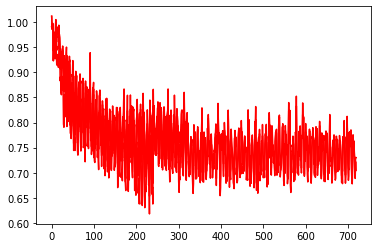

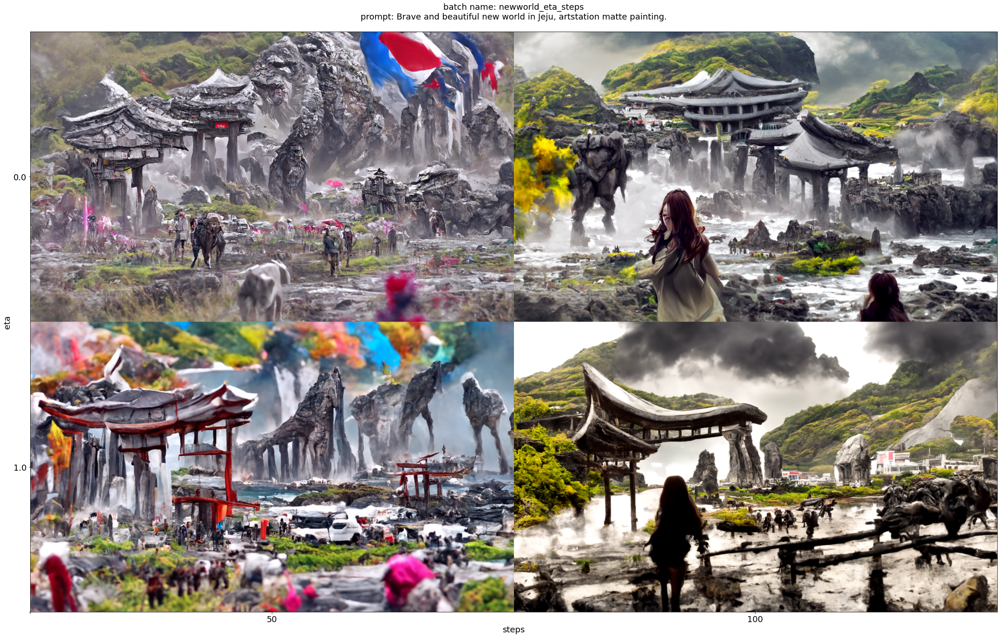

Saved collage to /workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_steps_batch_configs.png
['/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_steps_batch_configs.yaml']


In [4]:
batch_name = "newworld"
text_prompts = "Brave and beautiful new world in Jeju, artstation matte painting."
set_seed = 123
batch_args = {
    "clip_guidance_scale": [1000, 5000, 10000, 50000],
    "steps": [50, 100, 250, 500],
    "tv_scale": [0, 1000, 10000, 20000],
    "eta": [0.0, 0.4, 0.8, 1.0],
    "clamp_max": [0.01, 0.05, 0.5],
    "cut_overview": ["[12]*1000", "[12]*400+[4]*600", "[1]*1000"],
    "cut_innercut": ["[12]*1000", "[4]*400+[12]*600", "[1]*1000"],
    "cut_ic_pow": [1, 10, 100],
    "cutn_batches": [2, 4, 8],
}
batch_args = {
    "clip_guidance_scale": [1000, 5000],
    "steps": [50, 100],
    "tv_scale": [0, 1000],
    "eta": [0.0, 1.0],
    "clamp_max": [0.01, 0.5],
    "cut_overview": ["[12]*1000", "[1]*1000"],
    "cut_innercut": ["[12]*1000", "[1]*1000"],
    "cut_ic_pow": [1, 100],
    "cutn_batches": [1, 4],
}
batch_pairs = [
#     ("clip_guidance_scale", "steps", "tv_scale"),
    ("eta", "steps"),
#     ("clamp_max", "steps"),
#     ("eta", "clamp_max"),
#     ("cut_overview", "cut_innercut"),
#     ("cut_ic_pow", "cutn_batches"),
]
batch_results = disco.batch_imagine(
    text_prompts=text_prompts, 
    batch_name=batch_name, 
    batch_args=batch_args, 
    batch_pairs=batch_pairs,
    set_seed=set_seed
)
print(batch_results)

In [5]:
# batch_results = ['/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_clip_guidance_scale_steps_tv_scale_batch_configs.yaml', '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_steps_batch_configs.yaml', '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_clamp_max_steps_batch_configs.yaml', '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_clamp_max_batch_configs.yaml', '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_cut_overview_cut_innercut_batch_configs.yaml', '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_cut_ic_pow_cutn_batches_batch_configs.yaml']
batch_results

['/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_clip_guidance_scale_steps_tv_scale_batch_configs.yaml',
 '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_steps_batch_configs.yaml',
 '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_clamp_max_steps_batch_configs.yaml',
 '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_clamp_max_batch_configs.yaml',
 '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_cut_overview_cut_innercut_batch_configs.yaml',
 '/workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_cut_ic_pow_cutn_batches_batch_configs.yaml']

## Collage batch results

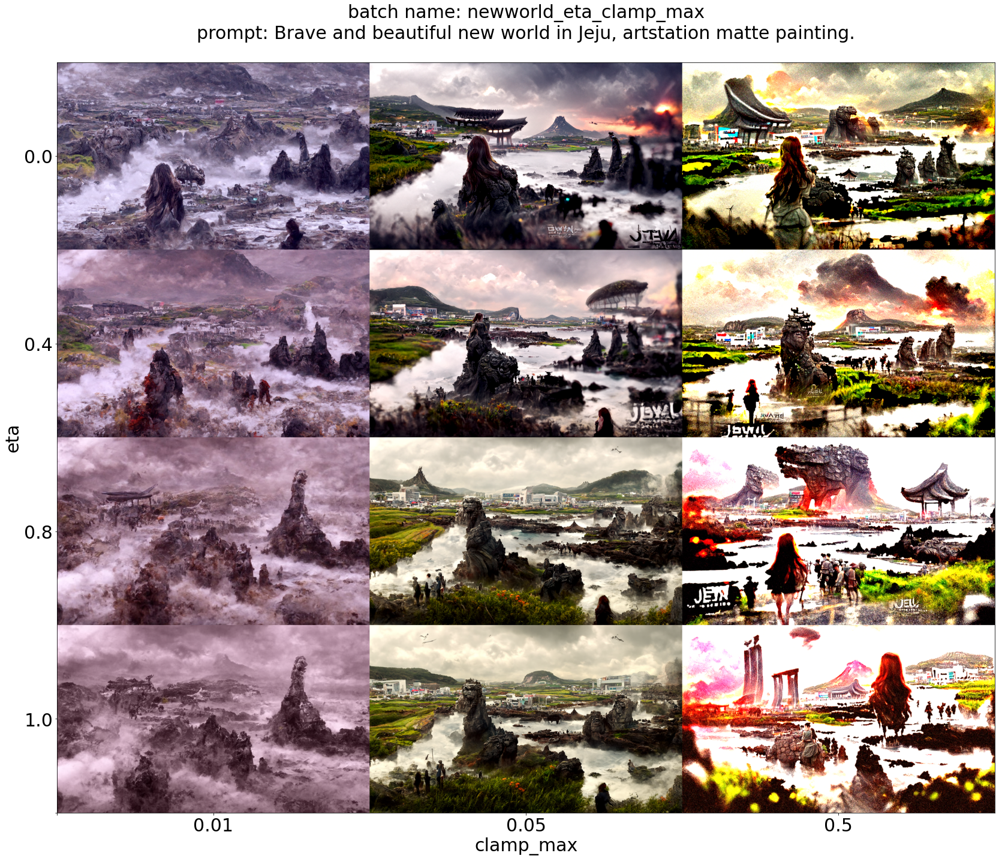

Saved collage to /workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_eta_clamp_max_batch_configs.png


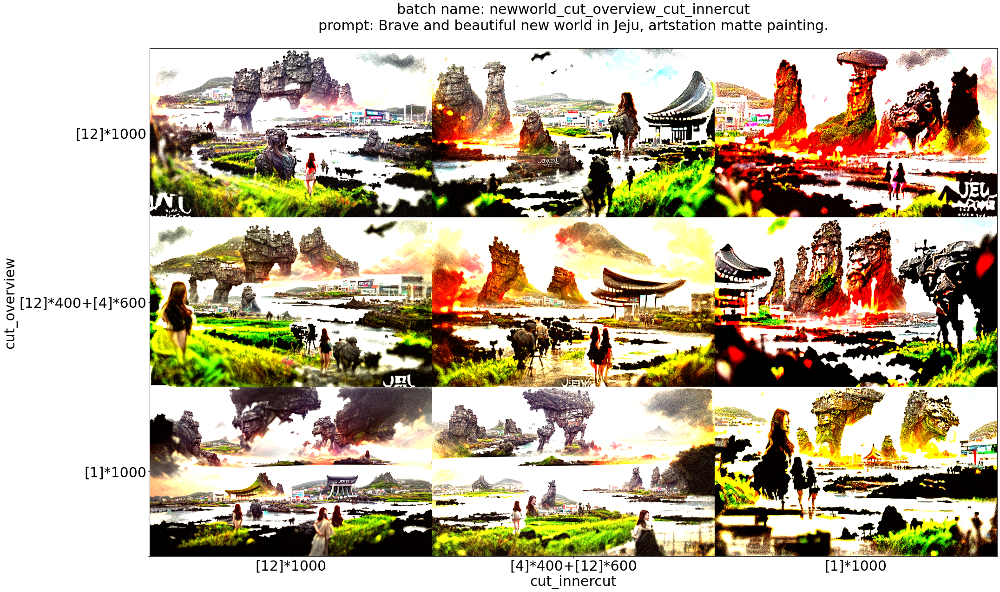

Saved collage to /workspace/projects/ekorpkit-book/disco-imagen/outputs/disco-diffusion/batch_configs/newworld_cut_overview_cut_innercut_batch_configs.png


In [8]:
for batch_config_path in batch_results[3:5]:
    disco.batch_collage(
        batch_config_path=batch_config_path,
        prompt_fontsize=30,
        fontsize=30,
    )
